In [68]:
import matplotlib.pyplot as plt
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import os
import essentia.standard as ess
import soundfile as sf

In [92]:
soundsDIR = '../gnaimeh/tempft/'
audio_file = soundsDIR + 'kompaktarchive/2013/03-2013/20/Saschienne - Grand Cru Remixe [KOMPAKT281]/01-Saschienne-Grand Cru (Extended Version)-electrobuzz.net.mp3'


In [76]:
ipd.Audio(audio_file)

In [77]:
audio_file, sr = librosa.load(audio_file)

In [78]:
audio_file.shape

(9272273,)

In [79]:
sample_duration = 1 / sr
print(f"One sample lasts for {sample_duration:6f} seconds")

One sample lasts for 0.000045 seconds


In [80]:
tot_samples = len(audio_file)
tot_samples

9272273

In [81]:
# duration of debussy audio in seconds
duration = 1 / sr * tot_samples
print(f"The audio lasts for {duration} seconds")

The audio lasts for 420.5112471655329 seconds


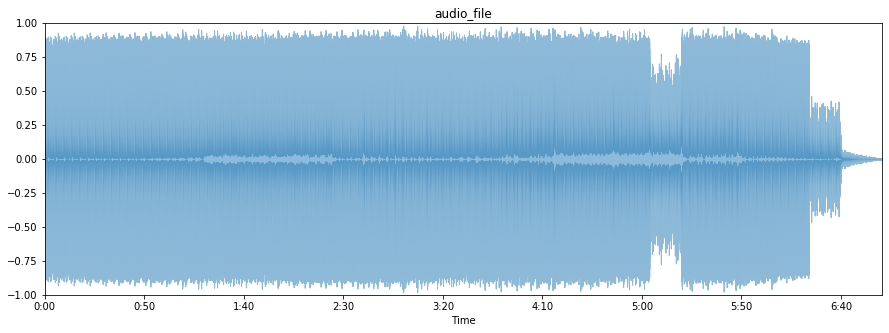

In [82]:
plt.figure(figsize=(15, 17))

plt.subplot(3, 1, 1)
librosa.display.waveplot(audio_file, alpha=0.5)
plt.ylim((-1, 1))
plt.title('audio_file')
plt.show()

In [83]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

def amplitude_envelope(signal, frame_size, hop_length):
    """Calculate the amplitude envelope of a signal with a given frame size nad hop length."""
    amplitude_envelope = []
    
    # calculate amplitude envelope for each frame
    for i in range(0, len(signal), hop_length): 
        amplitude_envelope_current_frame = max(signal[i:i+frame_size]) 
        amplitude_envelope.append(amplitude_envelope_current_frame)
    
    return np.array(amplitude_envelope)

In [84]:
ae_audio_file = amplitude_envelope(audio_file, FRAME_SIZE, HOP_LENGTH)
len(ae_audio_file)

18110

In [85]:
frames = range(len(ae_audio_file))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

<function matplotlib.pyplot.show(*args, **kw)>

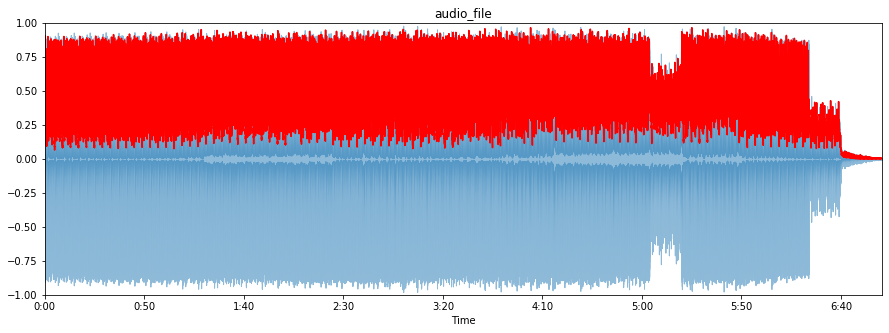

In [86]:
plt.figure(figsize=(15, 17))

ax = plt.subplot(3, 1, 1)
librosa.display.waveplot(audio_file, alpha=0.5)
plt.plot(t, ae_audio_file, color="r")
plt.ylim((-1, 1))
plt.title("audio_file")
plt.show

In [87]:
z = np.argmax(ae_audio_file)
print(z)

10509


In [88]:
ae_time = z*HOP_LENGTH/sr
print(ae_time)

244.01850340136053


In [89]:
max_ldns_pos = (ae_time/duration)*100
print(max_ldns_pos)

58.02900755834087


In [93]:
x, sr = librosa.load(audio_file)

In [94]:
x.shape

(9272273,)

In [95]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

def amplitude_envelope(signal, frame_size, hop_length):
    """Calculate the amplitude envelope of a signal with a given frame size nad hop length."""
    amplitude_envelope = []
    
    # calculate amplitude envelope for each frame
    for i in range(0, len(signal), hop_length): 
        amplitude_envelope_current_frame = max(signal[i:i+frame_size]) 
        amplitude_envelope.append(amplitude_envelope_current_frame)
    
    return np.array(amplitude_envelope)

In [96]:
ae_audio_file = amplitude_envelope(x, FRAME_SIZE, HOP_LENGTH)
print(len(ae_audio_file))
z = np.argmax(ae_audio_file)
print(z)
ae_time = z*HOP_LENGTH/sr
print(ae_time)
max_ae_pos = (ae_time/duration)*100
print(max_ae_pos)
rmse_x = librosa.feature.rms(x, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
print(np.argmax(rmse_x))
y = np.argmax(rmse_x)
rmse_x_time = y*HOP_LENGTH/sr
print(rmse_x_time)
max_rmse_pos = (rmse_x_time/duration)*100
print(max_ldns_pos)
vol_rms =  x.max()/np.sqrt(2)
print((vol_rms))

18110
10509
244.01850340136053
58.02900755834087
412
9.566621315192744
58.02900755834087
0.6829166817774168


In [97]:
count = 0
count_songs = 0
labels = []
labels_dict = dict()


for root, dirs, files in os.walk ('../gnaimeh/tempft/'):
    count += 1
    if count==1:
        labels = [label for label in dirs if not label.startswith('.')]
    else:
        break
        
for l in labels:
    count_songs = 0
    for root, dirs, files in os.walk('../gnaimeh/tempft/'+l):
        for file in files:
            if  file.endswith('.mp3'):
                count_songs += 1
    
                
    print(l, " songs ", count_songs)       
    if "name" in labels_dict:
        labels_dict["name"].append(l)
        labels_dict['number_songs'].append(count_songs)
    else:
        labels_dict["name"] = [l]
        labels_dict["number_songs"] = [count_songs]

kompaktarchive  songs  329


In [98]:
import sys
import warnings

if not sys.warnoptions:
    warnings.simplefilter("ignore")
    

In [ ]:
data_file = os.path.join('../gnaimeh/'+ 'LDNS_pos_KL.csv')
countlabel = 0
count = 0
nfiles = 305
nfiles = min(labels_dict["number_songs"])

# extract features to csv
with open(data_file, 'w') as writer:
    # write features titles
    line2write = 'pos_max_ae' + 'pos_max_rmse' + 'vol_rms' + ',label' '\n'
    writer.write(line2write)

    for l in labels_dict['name']:
        # for each label
        print(l)
        count = 0
        for root, dirs, files in os.walk ('../gnaimeh/tempft/'+l):
            # iterate files at label directory
            # extract features from at most nfiles which is the minimal
            # number of files in all labels
            if count >= nfiles:
                count = 0
                break
            for file in files:
                if not file.startswith('.') and file.endswith('.mp3'):
                    # if file is a song
                    # extract features and write them to csv
                    # increase count to stop at nfiles
                    if count < nfiles:
                        count += 1
                        # display progress every 20 files
                        if count % 1 == 0:
                            print(count, "files processed, current file: ",file)
                            
                            
                        x, sr = librosa.load(root+'/'+file)
                        ae_audio_file = amplitude_envelope(x, FRAME_SIZE, HOP_LENGTH)
                        z = np.argmax(ae_audio_file)
                        ae_time = z*HOP_LENGTH/sr
                        pos_max_ae = (ae_time/duration)*100
                        
                        rmse_x = librosa.feature.rms(x, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
                        y = np.argmax(rmse_x)
                        rmse_x_time = y*HOP_LENGTH/sr
                        pos_max_rmse = (rmse_x_time/duration)*100
                        
                        vol_rms =  x.max()/np.sqrt(2)
                        
     
                        line2write = str(pos_max_ae) +','+str(pos_max_rmse)+ ',' + str(vol_rms)+','+ l + '\n'
                        writer.write(line2write)

                    else:
                        # we extracted nfiles start a new label
                        print(l)
                        print(count)
                        print("Another label")
                        break



print('Files processed ', count)

kompaktarchive
1 files processed, current file:  02-saschienne-unknown-electrobuzz.net.mp3
2 files processed, current file:  01-saschienne-unknown_(dixon_mix)-electrobuzz.net.mp3
3 files processed, current file:  01-Walls-Gaberdine (Gerd Janson & Prins Thomas Remix)-electrobuzz.net.mp3
4 files processed, current file:  02-Walls-Gaberdine (Walls Edit)-electrobuzz.net.mp3
5 files processed, current file:  05-john_tejada-radio_channel-electrobuzz.net.mp3
6 files processed, current file:  02-superpitcher-moon_fever_remixe_(lawrence_ambient_mix)-electrobuzz.net.mp3
7 files processed, current file:  03-superpitcher-moon_fever_remixe_(lawrence_mix)-electrobuzz.net.mp3
8 files processed, current file:  01-superpitcher-moon_fever_remixe_(gluteus_maximus_mix)-electrobuzz.net.mp3
9 files processed, current file:  01-WhoMadeWho-Never Had The Time (Mind Against Remix)-electrobuzz.net.mp3
10 files processed, current file:  03-WhoMadeWho-Never Had The Time (Saschienne Remix)-electrobuzz.net.mp3
11 fi

91 files processed, current file:  Max Würden - 186.000 Miles Per Second (Original Mix) [Kompakt].mp3
92 files processed, current file:  Blondish-Endless Games (Slow Version)-electrobuzz.mp3
93 files processed, current file:  Blondish-Nada Brahma-electrobuzz.mp3
94 files processed, current file:  03 - Lucy?s Affair (Slow Version).mp3
95 files processed, current file:  Blondish-Velvet Wave (Slow Version)-electrobuzz.mp3
96 files processed, current file:  Blondish-Jupiter & Jaguar-electrobuzz.mp3
97 files processed, current file:  Blondish-Los Pensamientos-electrobuzz.mp3
98 files processed, current file:  Blondish-Shy Grass-electrobuzz.mp3
99 files processed, current file:  Blondish-Moonvalley-electrobuzz.mp3
100 files processed, current file:  Blondish-Inner Jungle-electrobuzz.mp3
101 files processed, current file:  Blondish-It Starts Now-electrobuzz.mp3
102 files processed, current file:  Blondish-Myein Caravan-electrobuzz.mp3
103 files processed, current file:  Patrice B?umel-Lowride

185 files processed, current file:  04_The Field-Something Left, Something Right, Something Wrong (Original Mix) (Kompakt)-electrobuzz.net.mp3
186 files processed, current file:  02 - Elektrisiermaschine Kompakt Extra.mp3
187 files processed, current file:  01 - Galaxy In An Atom Kompakt Extra.mp3
188 files processed, current file:  03-jatoma-dust_in_wong.mp3
189 files processed, current file:  01-jatoma-little_houseboat.mp3
190 files processed, current file:  07-jatoma-bou.mp3
191 files processed, current file:  11-jatoma-helix.mp3
192 files processed, current file:  09-jatoma-paper_lights.mp3
193 files processed, current file:  02-jatoma-manipura.mp3
194 files processed, current file:  12-jatoma-ma10as.mp3
195 files processed, current file:  13-jatoma-luvdisc.mp3
196 files processed, current file:  10-jatoma-permafrost.mp3
197 files processed, current file:  04-jatoma-alang_beach.mp3
198 files processed, current file:  08-jatoma-smoking_keys.mp3
199 files processed, current file:  05